# Fitting a model to a star spectrum with Metropolis-Hastings algorithm

In [248]:
# define a simple black body + dust extinction model


def calzetti_extinction(wavelength, R_V=4.05):
    wavelength = np.atleast_1d(wavelength)
    k_lambda = np.zeros_like(wavelength)
    
    # UV to optical: 0.12 µm ≤ λ < 0.63 µm
    uv_opt_mask = (wavelength >= 0.12) & (wavelength < 0.63)
    lambda_uv_opt = wavelength[uv_opt_mask]
    k_lambda[uv_opt_mask] = (
        2.659 * (-2.156 + 1.509 / lambda_uv_opt - 0.198 / lambda_uv_opt**2 + 0.011 / lambda_uv_opt**3) + R_V
    )
    
    # Optical to NIR: 0.63 µm ≤ λ ≤ 2.2 µm
    opt_nir_mask = (wavelength >= 0.63) & (wavelength <= 2.2)
    lambda_opt_nir = wavelength[opt_nir_mask]
    k_lambda[opt_nir_mask] = (
        2.659 * (-1.857 + 1.040 / lambda_opt_nir) + R_V
    )

    return k_lambda[0] if wavelength.size == 1 else k_lambda

def model(w,T_star,R_star,EBmV):
    """
    Assuming perfect black body of temperature T and emitting surface R + dust extinction
    w in Armstrong
    returns observed specific flux in erg/s/cm^2/armstrong 
    """
    w_cm = w * 1e-8 # wavelength in cm
    R_star = R_star 
    
    black_body = (2 * h * c**2) / (w_cm**5) * 1 / (np.exp((h * c) / (w_cm * k_B * T_star)) - 1)

    intrinsic_flux = 1e-8 * (R_star**2/distance**2) * np.pi * black_body

    w_micron = w*1e-4 
    extinction = np.exp(-calzetti_extinction(w_micron,4.1) * EBmV)

    return intrinsic_flux * extinction

# constants

h = 6.67e-27
k_B = 1.38e-16
c = 2.99e10 
parsec = 3.086e+18
T_sun = 5778 # K
R_sun = 6.96e10 # cm

In [249]:
distance = 1010 * parsec # distance is known (from parallax)

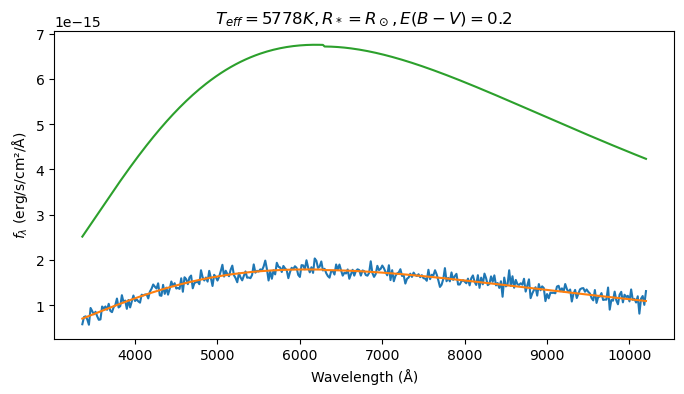

In [250]:
# generate a toy spectra assuming to know E(B-V) = 0.2, T_eff = T_sun and R_star = R_sun

w = np.arange(3360,10220,20)

from scipy.stats import norm

sigma = 1e-16 #cgs
toy_spectra = model(w,T_star=T_sun,R_star=R_sun,EBmV=0.2) + norm(loc=0,scale=sigma).rvs(len(w))

import matplotlib.pyplot as plt

fig,ax = plt.subplots(figsize=(8,4))

plt.plot(w,toy_spectra)
plt.plot(w,model(w,T_star=T_sun,R_star=R_sun,EBmV=0.2))
plt.plot(w,model(w,T_star=5680,R_star=1.4e11,EBmV=0.2))
#plt.errorbar(w,toy_spectra,sigma)
plt.xlabel("Wavelength (Å)", fontsize=10)
plt.ylabel('$f_\lambda$ (erg/s/cm²/Å)', fontsize=10)
plt.title("$T_{eff} = 5778 K, R_* = R_\odot, E(B-V) = 0.2$")
plt.show()

## Maximum a posterior (MAP)

Bayes' Theorem:

$$ \mathrm{Posterior} = \frac{\mathrm{Likelihood}\times\mathrm{Prior}}{\mathrm{Evidence}} $$

$$p(M,\theta \,|\,D,I) = \frac{p(D\,|\,M,\theta,I)\,\times p(M,\theta\,|\,I)}{p(D\,|\,I)},$$

Assume $N$ measurements of the flux at $N$ different wavelenghts $\lambda_i$, where the uncertainty for each measurement is Gaussian with a known $\sigma_i$ (the flux error). The likelihood of one measurement is 

$$L \equiv p(x(\lambda_i)|\mu(\lambda_i),\sigma_i) = \frac{1}{\sigma_i\sqrt{2\pi}} \exp\left(\frac{-(x(\lambda_i)-\mu(\lambda_i))^2}{2\sigma_i^2}\right).$$

where $\mu(\lambda_i) = M(\theta,\lambda_i)$ is the model evaluated at each wavelength, for a given set of parameters.


and therefore the likelihood of all N measurements is

$$L \equiv p(\{x_i\}|\mu,\sigma_i) = \prod_{i=1}^N \frac{1}{\sigma_i\sqrt{2\pi}} \exp\left(\frac{-(x(\lambda_i)-\mu(\lambda_i))^2}{2\sigma_i^2}\right).$$

## The Metropolis-Hastings Algorithm <a class="anchor" id="three"></a>

**The Metropolis-Hastings algorithm** adopts the following acceptance probability for newly proposed points to step to:

$$ p_{\rm acc}(\theta_i,\theta_{i+1}) = { p(\theta_{i+1}) \over p(\theta_i) }, $$

where the proposed point $\theta_{i+1}$ is drawn from an *arbitrary* symmetric density distribution $T(\theta_{i+1}\,|\,\theta_i)$. Since it is symmetric, the **ratio of transition probabilities cancels out and detailed balance is ensured**. A Gaussian distribution centered on the current point $\theta_i$ is often used for $T(\theta_{i+1}|\theta_i)$.

This algorithm guarantees that the chain will reach an equilibrium, or stationary, distribution, and it will approximate a sample drawn from $p(\theta)$! 

**In summary, the Metropolis-Hastings algorithm consists of these steps:**

1. Given $\theta_i$ and $T(\theta_{i+1}|\theta_i)$, draw a proposed value for $\theta_{i+1}.$ 
2. Compute acceptance probability $p_{\rm acc}(\theta_i,\theta_{i+1})$.
3. Draw a random number between 0 and 1 from a uniform distribution; if it is smaller than $p_{\rm acc}(\theta_i,\theta_{i+1})$, then accept $\theta_{i+1}$. 
4. ***If $\theta_{i+1}$ is accepted added it to the chain. If not, add $\theta_{i}$ to the chain.***
5. Use the chain (of $\theta$ values) for inference; e.g. a histogram of $\theta$ is an estimator of the posterior pdf for $\theta$, $p(\theta)$, and the expectation value for $\theta$ can be computed from 

  $$ I = \int g(\theta) \, p(\theta) \, d\theta = \frac{1}{N} \sum_{i=1}^N g(\theta_i).$$

where N is the number of elements in the chain (e.g. the expectation value for $\theta$ is simply the mean value of chain elements). 

***Step 4*** is very important. If we only accepted points of higher probability then we would only move up the posterior density to find its maximum. But we want to map out the full posterior density, so sometimes we must settle for less!

**Optimal width**

The optimal proposal width in the Metropolis-Hastings algorithm balances between:

- High acceptance rate (~40-50%) for good exploration of the parameter space.
- Low autocorrelation for better mixing and faster convergence.

If acceptance rate > 50%, increase proposal width (exploration is too local).
If acceptance rate < 20%, decrease proposal width (steps are too large, leading to rejections).

In [308]:
from scipy import stats
np.random.seed(21)
Ndata = 200
mu = 1.0
sigma = 1.0
data = norm(mu, sigma).rvs(Ndata)

def logLikelihood(x,data):
    # Gaussian likelihood 
    return np.sum(stats.norm(loc=x[0], scale=x[1]).logpdf(data))

def Prior(x):
    # create a uniform prior in mu and sigma
    prior_mu = stats.uniform.pdf(x[0], loc=0.5, scale=1.0)
    prior_sigma = stats.uniform.pdf(x[1], loc=0.5, scale=1.0)
    return  prior_mu * prior_sigma


def logPosterior(x,data):
    
    lp =  np.log(Prior(x))
    if not np.isfinite(lp):
        return -np.inf
    else:
        return logLikelihood(x,data) + lp


In [311]:
samples = Metropolis_Hastings(data, 3000, params_init=[1.1,1.5], proposal_width=[0.1,0.1])

/tmp/ipykernel_6474/614348392.py:21: RuntimeWarning: divide by zero encountered in log
  lp =  np.log(Prior(x))


Acceptance rate: 0.37166666666666665


In [276]:

def LogLikelihood(params,data):
    T_star = T_sun
    R_star, EBmV = params[0],params[1]
    model_arr = model(data[0],T_star,R_star,EBmV)
    p_lambda = - np.log((data[2] * np.sqrt(2*np.pi))) - (data[1] - model_arr )**2 / (2*data[2]**2)

    return np.sum(p_lambda)


def LogPrior(params): 
    R_star, EBmV = params[0],params[1]
    T_star = T_sun
    if T_star < 1000 or T_star > 40000 or R_star < 0.1 * R_sun or R_star > 2 * R_sun or EBmV < 0 or EBmV > 0.5:
        return -np.inf
    else:
        return 0  

def LogPosterior(params,data):
    return LogLikelihood(params,data) + LogPrior(params) 


In [282]:
print(LogLikelihood([R_sun+0.9*R_sun,0.2],[w,flux,flux_err]))

-172.4690928279873


In [300]:
def Metropolis_Hastings(data, N, params_init, proposal_width):
    params = np.array(params_init, dtype=float)  # Initialize parameters as a float array
    samples = [params.copy()]
    dim = len(params_init)
    accepted = 0

    log_p_current = logPosterior(params,data)

    for i in range(N-1):
        # Propose new parameters
        params_proposal = params + np.random.normal(0, proposal_width, size=dim)

        # Compute log-posterior for the proposal
        log_p_proposal = logPosterior(params_proposal,data)

        # Acceptance probability
        #log_acceptance = log_p_proposal - log_p_current
        #print(log_p_current)
        #print(log_p_proposal)
        #print(log_acceptance)
        #print(np.log(np.random.rand()))
        #if np.log(np.random.rand()) < log_acceptance: print("yes")
        #print("\n")
        
        # Numerically stable acceptance probability
        log_acceptance = np.clip(log_p_proposal - log_p_current, -50, 50)
        
        if np.log(np.random.rand()) < log_acceptance:
            params = params_proposal
            log_p_current = log_p_proposal
            accepted += 1
  
        samples.append(params.copy())

    print("Acceptance rate:", accepted / N)
    return samples

Acceptance rate: 0.00155


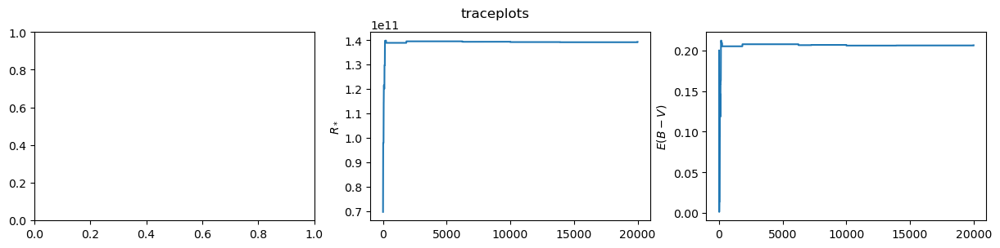

In [294]:
N = 20000
params_init=[1*R_sun,0.2]           # T in K, R in R_sun

proposal_width=[0.05*R_sun,0.05] # T in K, R in R_sun

samples = Metropolis_Hastings([w,flux,flux_err], N=N, params_init=params_init, proposal_width=proposal_width)
samples = np.array(samples)

acceptance_rate = np.mean(np.diff(samples[:, 0]) != 0)  # For T_eff
#print("Acceptance rate:", acceptance_rate)

fig, ax = plt.subplots(1,3,figsize=(15,3))
fig.suptitle("traceplots")

#ax[0].plot(range(N), samples[:,0])
#ax[0].set_ylabel("$T_{eff}$")

ax[1].plot(range(N), samples[:,0])
ax[1].set_ylabel("$R_*$")

ax[2].plot(range(N), samples[:,1])
ax[2].set_ylabel("$E(B-V)$")

plt.show()


In [150]:
print(samples.shape)

(20000, 2)


In [235]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import display, clear_output
import time
import threading

def Animated_Metropolis_Hastings(data, N, params_init, proposal_width, prior_space, param_names):

    # create the corner plot
    
    ndims = len(params_init)
        
    fig, axes = plt.subplots(ndims, ndims, figsize=(2 * ndims, 2 * ndims))

    for i in range(ndims):
        for j in range(ndims):
            ax = axes[i, j]
            
            if i < j:
                # Upper triangle: hide plots
                ax.set_visible(False)
            elif i == j:
                # Diagonal: histogram placeholder
                ax.set_xlim(prior_space[j][0], prior_space[j][1])  
                ax.set_yticks([])
                #ax.set_xlabel(param_names[i])
            else:
                # Lower triangle: scatter plot placeholders
                ax.set_xlim(prior_space[j][0], prior_space[j][1])  
                ax.set_ylim(prior_space[i][0], prior_space[i][1])
                
                if j == 0:
                    ax.set_ylabel(param_names[i])
                if i == ndims - 1:
                    ax.set_xlabel(param_names[j])

    plt.tight_layout()

    # plot initial draw

    for j in range(ndims):
        for i in range(j+1,ndims):
            ax = axes[i,j]
            print(i,j)
            scat = ax.scatter(params_init[j], params_init[i], c='black', s=10)

    # implement metropolis hasting algorithm



    


In [236]:
a = [[1,2],[3,4],[5,6],[7,8]]
#print(a[0][1])

for i in range(1,3): print(i)

1
2


1 0
2 0
3 0
2 1
3 1
3 2


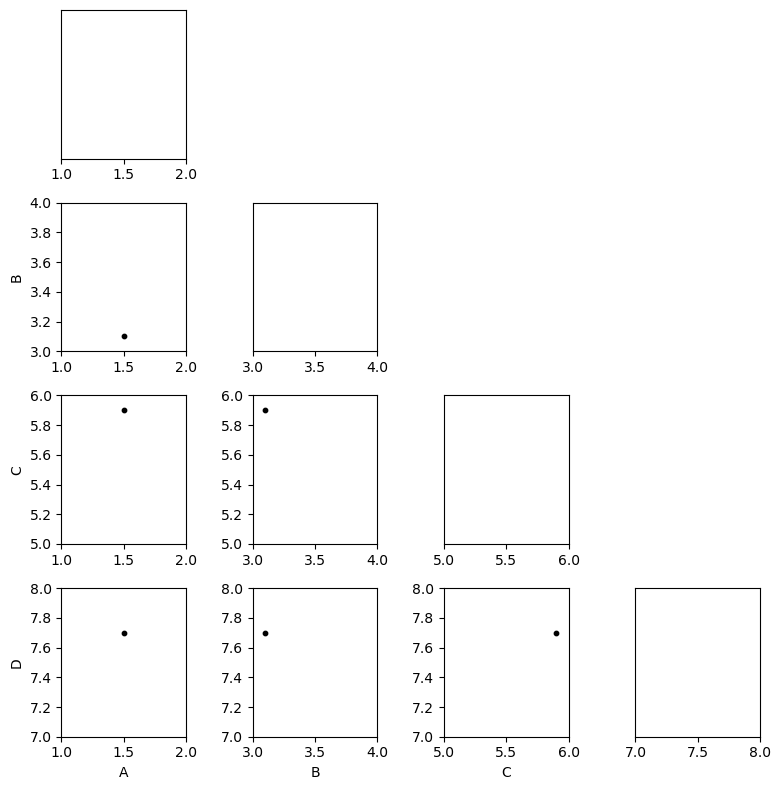

In [237]:
Animated_Metropolis_Hastings(1,1,[1.5,3.1,5.9,7.7],1, [[1,2],[3,4],[5,6],[7,8]],['A','B','C','D'])




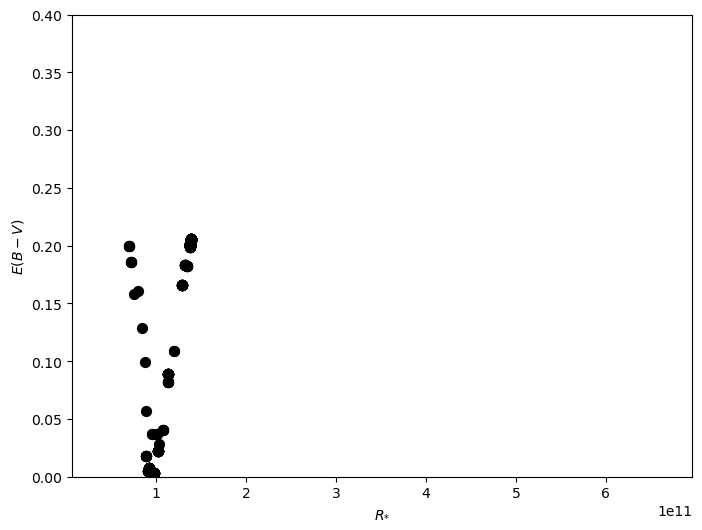

In [176]:







#from mpl_toolkits.mplot3d import Axes3D
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Sample output from Metropolis-Hastings
samples = np.array(samples)  # Assuming 'samples' is from the Metropolis_Hastings function

# Define parameter bounds
R_min, R_max = 0.1*R_sun, 10*R_sun  # Assuming R_sun = 1 for simplicity
EBmV_min, EBmV_max = 0, 0.4

# Create the 2D plot
fig, ax = plt.subplots(figsize=(8, 6))
ax.set_xlim(R_min, R_max)
ax.set_ylim(EBmV_min, EBmV_max)
ax.set_xlabel(r"$R_{*}$")
ax.set_ylabel(r"$E(B-V)$")

# Initial scatter plot
scat = ax.scatter([], [], c='black', s=50)

# Animation update function
def update(frame):
    # Get the new data point
    R_star, EBmV = samples[frame, 0], samples[frame, 1]
    
    # Append the new data to the existing scatter plot
    offsets = scat.get_offsets()
    new_offsets = np.vstack([offsets, [R_star, EBmV]]) if offsets.size else np.array([[R_star, EBmV]])
    
    # Update scatter plot with new data
    scat.set_offsets(new_offsets)
    
    return scat,

# Create the animation
ani = FuncAnimation(fig, update, frames=1000, blit=True, interval=30, repeat=False) #init_func=init

# Display the animation in the notebook
HTML(ani.to_jshtml())

#plt.close()


In [181]:
import itertools
import threading
import time
import sys

done = False
#here is the animation
def animate():
    for c in itertools.cycle(['|', '/', '\\']):
        if done:
            break
        sys.stdout.write('\rloading ' + c)
        sys.stdout.flush()
        time.sleep(0.1)
    sys.stdout.write('\rDone!     ')

t = threading.Thread(target=animate)
t.start()

#long process here
time.sleep(10)
done = True

[2.13040673 0.13659777 6.26154789]


In [ ]:
# Initial scatter and line plot
scat = ax.scatter([], [], c='blue', alpha=0.8)
line, = ax.plot([], [], 'r-', lw=1)

# Initialization function
def init():
    scat.set_offsets([])
    line.set_data([], [])
    return scat, line

# Animation function
def update(frame):
    R_star, EBmV = samples[frame, 1], samples[frame, 2]

    # Check if within bounds
    in_bounds = (R_min < R_star < R_max) and (EBmV_min < EBmV < EBmV_max)
    
    # Get existing data
    current_data = scat.get_offsets()
    xdata, ydata = (list(current_data[:, 0]), list(current_data[:, 1])) if len(current_data) > 0 else ([], [])
    
    # Add new point
    xdata.append(R_star)
    ydata.append(EBmV)
    
    # Update scatter plot
    alpha = 0.8 if in_bounds else 0.1  # Higher transparency if out-of-bounds
    scat.set_offsets(np.column_stack((xdata, ydata)))
    scat.set_alpha(alpha)
    
    # Update line (for jump visualization)
    if len(xdata) > 1:
        line.set_data(xdata[-2:], ydata[-2:])
    else:
        line.set_data([], [])
    
    return scat, line

In [126]:
import emcee

ndim = 3  # number of parameters in the model
nwalkers = 8  # number of MCMC walkers
burn = 1000  # "burn-in" period to let chains stabilize
nsteps = 40000  # number of MCMC steps to take **for each walker**

# initialize parameters
#starting_guesses =  np.array( [scipy.stats.uniform(loc=0,scale=50).rvs(size=nwalkers), \
#                   scipy.stats.uniform(loc=0,scale=50).rvs(size=nwalkers), \
#                   scipy.stats.uniform(loc=0,scale=100).rvs(size=nwalkers), \
#                   scipy.stats.loguniform.rvs(np.exp(-5),np.exp(5),size=nwalkers)]).T

theta_quick= np.array([T_sun,R_sun,0.2])
starting_guesses = theta_quick + 1e-1* np.random.randn(nwalkers, ndim)

# the function call where all the work happens: 
sampler = emcee.EnsembleSampler(nwalkers, ndim, LogPosterior, args=[[w,flux,flux_err]])
sampler.run_mcmc(starting_guesses, nsteps, progress=True)
 

100%|████████████████████████████████████| 40000/40000 [00:50<00:00, 789.90it/s]


State([[5.59308936e+03 1.41151365e+11 1.75491525e-01]
 [5.60879796e+03 1.40928879e+11 1.78087420e-01]
 [5.67251511e+03 1.40738524e+11 1.90904106e-01]
 [5.67989771e+03 1.40548786e+11 1.91482011e-01]
 [5.70064891e+03 1.40106660e+11 1.94120601e-01]
 [5.59529245e+03 1.41215259e+11 1.76349601e-01]
 [5.65512759e+03 1.40856904e+11 1.87758081e-01]
 [5.68419933e+03 1.40239944e+11 1.91426904e-01]], log_prob=[10735.50819886 10736.29043252 10736.680782   10737.5028968
 10737.93817956 10736.58930087 10737.1276613  10736.96726449], blobs=None, random_state=('MT19937', array([2727814617, 1849935432, 2718835854,  515864998, 3962575297,
       2581528697,  488928471,  806773444, 3175399187,  498225507,
        964296033,  374968359, 1269468314, 1745768296, 1343751472,
       1636974491, 2618686315, 1944595072, 2029535106, 2011445895,
       4163031243, 1310694552, 3979002211,  165349977, 1452934615,
       3179539526,  765047845, 2115536428, 1281529300, 3548684363,
       1025092941, 3986329054, 301804

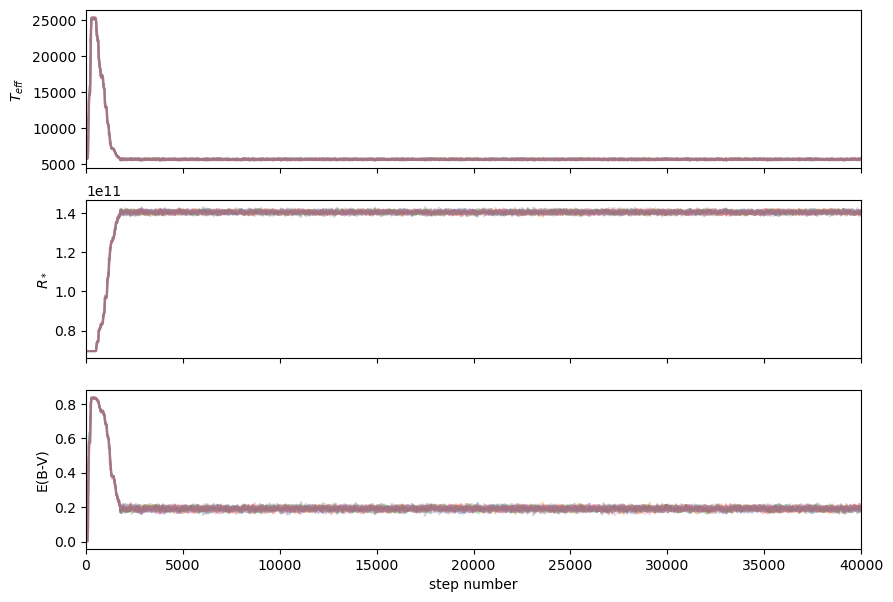

In [127]:
fig, axes = plt.subplots(3, figsize=(10, 7), sharex=True)
samples = sampler.get_chain()
labels = ["$T_{eff}$", "$R_*$", "E(B-V)"]
for i in range(ndim):
    ax = axes[i]
    ax.plot(samples[:,:, i], alpha=0.3)
    ax.set_xlim(0, len(samples))
    ax.set_ylabel(labels[i])
    #ax.yaxis.set_label_coords(-0.1, 0.5)

axes[-1].set_xlabel("step number");

In [119]:
flat_samples = sampler.get_chain(discard=2500, flat=True)

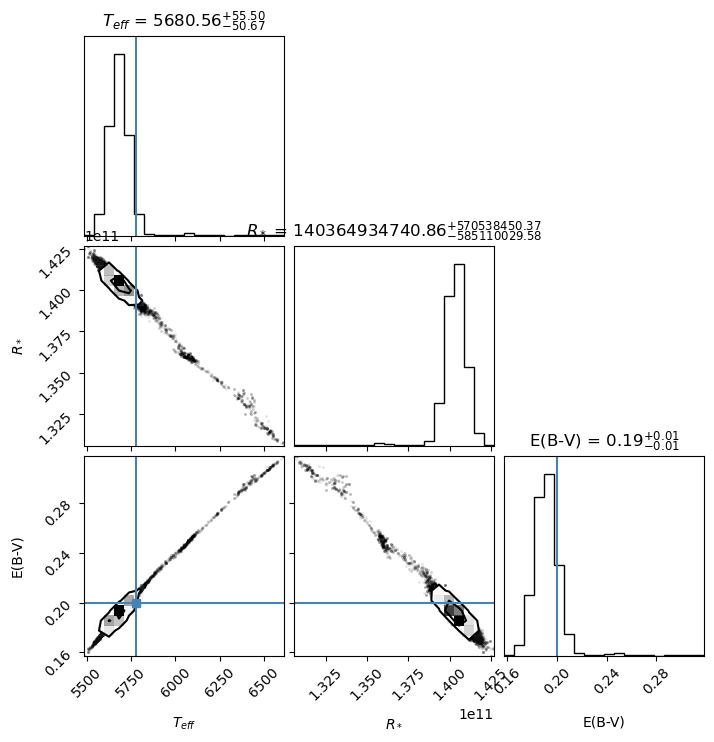

In [122]:
import corner

fig = corner.corner(
    flat_samples, labels=labels, levels=[0.68,0.95], truths=theta_quick,show_titles=True, title_kwargs={"fontsize": 12})


In [44]:
import numpy as np
from astropy.io import fits

file_path = "data/XP_SAMPLED-Gaia DR3 1974528755270167552.fits" 
hdul = fits.open(file_path)
#hdul.info()

primary_hdu = hdul[1].data
#print(hdul[1].header)

w_ = np.array(primary_hdu['wavelength']) * 10 # armstrong
flux = np.array(primary_hdu['flux']) * 1e2   # cgs
flux_err = np.array(primary_hdu['flux_error']) * 1e2 

In [5]:
w_downsampled = w[::30]
dx = 600 #np.diff(w_downsampled)
photometric_points = []
phot_error = []


for i in range(1,len(w_downsampled)+1):

    if i < len(w_downsampled):
        mask = (w > w_downsampled[i-1]) & (w <= w_downsampled[i])
    else:
        mask = (w > w_downsampled[i-1])
    
    mean = np.mean(flux[mask])
    std = np.std(flux[mask])
    photometric_points.append(mean)
    phot_error.append(std)

photometric_points = np.array(photometric_points)
phot_error = np.array(phot_error)

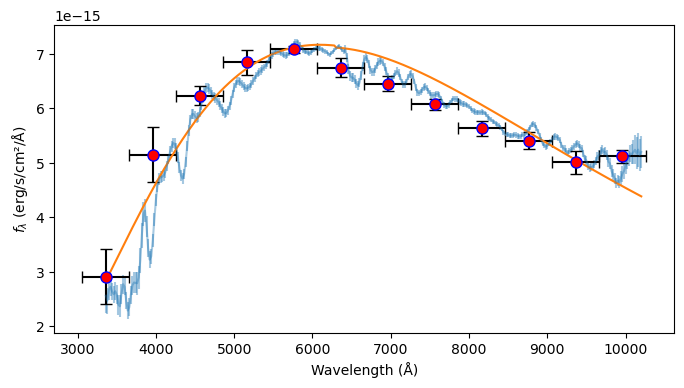

In [21]:
import matplotlib.pyplot as plt

fig,ax = plt.subplots(figsize=(8,4))

plt.errorbar(w,flux,flux_err,alpha=0.4,label='GAIA BP/RP')
plt.errorbar(w_downsampled,photometric_points,yerr=phot_error, xerr=dx/2,
             linestyle='',marker='o',markersize=8,color='red',markeredgecolor='blue',ecolor='black',capsize=4)
plt.ylabel('$f_\lambda$ (erg/s/cm²/Å)', fontsize=10)
plt.xlabel("Wavelength (Å)", fontsize=10)

plt.plot(w,model(w,1.0*T_sun,2.0*R_sun,0.2))
#plt.xlim(6000,6200)
plt.show()

In [10]:
print(likelihood_gaus(w_downsampled,photometric_points,phot_error,T_star=0.9*T_sun,R_star=2.1,EBmV=0.1))

print(log_likelihood(w_downsampled,photometric_points,phot_error,T_star=0.9*T_sun,R_star=2.1,EBmV=0.1))

print(log_likelihood_(w_downsampled,photometric_points,phot_error,T_star=0.9*T_sun,R_star=2.1,EBmV=0.1))
#print(log_posterior(w_downsampled,photometric_points,phot_error,T_star=0.9*T_sun,R_star=2.1,EBmV=0.1))
#print(log_posterior(w_downsampled,photometric_points,phot_error,T_star=0.9*T_sun,R_star=2.1,EBmV=0.1))
#print(log_posterior(w_downsampled,photometric_points,phot_error,T_star=0.9*T_sun,R_star=1.0,EBmV=0.0))

NameError: name 'norm' is not defined

In [24]:
from scipy.stats import norm


        

Acceptance rate: 0.00045002250112505623


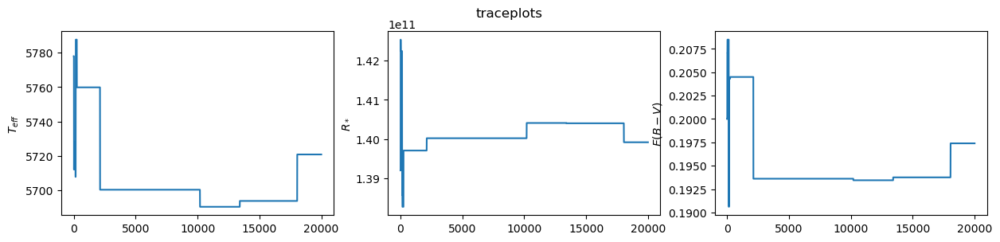

In [30]:
N = 20000
params_init=[1*T_sun,2*R_sun,0.2]           # T in K, R in R_sun

proposal_width=[T_sun/100,0.1*R_sun,0.01] # T in K, R in R_sun

samples = Metropolis_Hastings([w,flux,flux_err], N=N, params_init=params_init, proposal_width=proposal_width)
samples = np.array(samples)

acceptance_rate = np.mean(np.diff(samples[:, 0]) != 0)  # For T_eff
print("Acceptance rate:", acceptance_rate)

#acceptance_rate = np.mean(np.diff(samples[:, 1]) != 0)  # For R_star
#print("Acceptance rate R_star:", acceptance_rate)

#acceptance_rate = np.mean(np.diff(samples[:, 2]) != 0)  # For E(B-V)
#print("Acceptance rate E(B-V):", acceptance_rate)

fig, ax = plt.subplots(1,3,figsize=(15,3))
fig.suptitle("traceplots")

ax[0].plot(range(N), samples[:,0])
ax[0].set_ylabel("$T_{eff}$")

ax[1].plot(range(N), samples[:,1])
ax[1].set_ylabel("$R_*$")

ax[2].plot(range(N), samples[:,2])
ax[2].set_ylabel("$E(B-V)$")

plt.show()



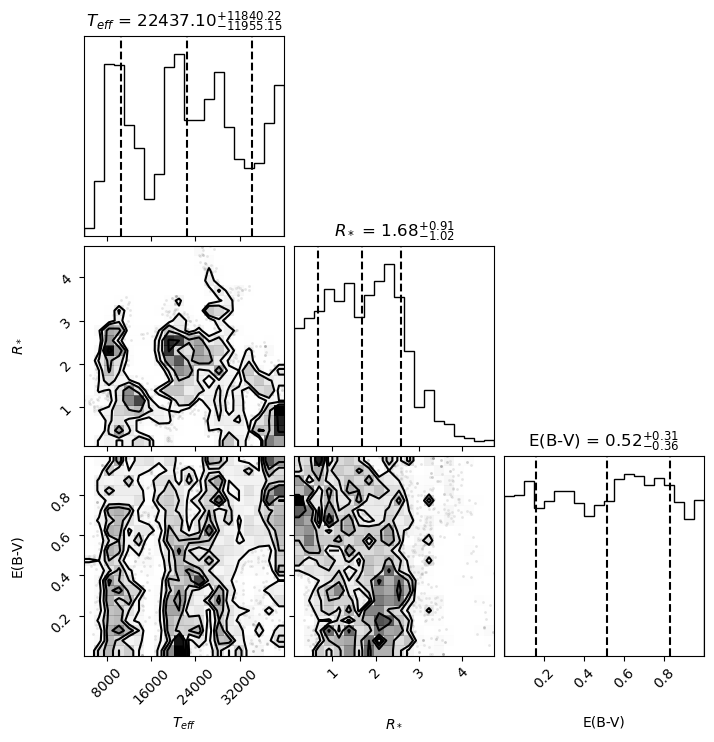

In [188]:
import corner

# Labels for each parameter
param_names = ["$T_{eff}$", "$R_*$", "E(B-V)"]

# Generate the corner plot
fig = corner.corner(samples, labels=param_names,
                    quantiles=[0.16, 0.5, 0.84], show_titles=True, title_kwargs={"fontsize": 12})  #truths=[true_params[p] for p in param_names]

plt.show()

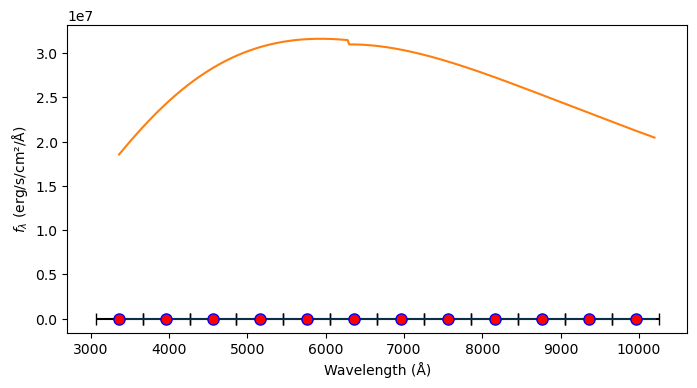

In [268]:
fig,ax = plt.subplots(figsize=(8,4))

plt.errorbar(w,flux,flux_err,alpha=0.4,label='GAIA BP/RP')
plt.errorbar(w_downsampled,photometric_points,yerr=phot_error, xerr=dx/2,
             linestyle='',marker='o',markersize=8,color='red',markeredgecolor='blue',ecolor='black',capsize=4)
plt.plot(w,model(w,11000,1.42*R_sun,0.6))
plt.ylabel('$f_\lambda$ (erg/s/cm²/Å)', fontsize=10)
plt.xlabel("Wavelength (Å)", fontsize=10)

#plt.plot(w,model(w,1*T_sun,1.3*R_sun,0))
#plt.xlim(6000,6200)
plt.show()

In [265]:
# With emcee
import emcee

ndim = 3  # number of parameters in the model
nwalkers = 6  # number of MCMC walkers
burn = 10000  # "burn-in" period to let chains stabilize
nsteps = 100000  # number of MCMC steps to take **for each walker**

# Define the posterior function
def log_posterior(theta, w_downsampled, photometric_points, phot_error):
    T_star, R_star, EBmV = theta
    return log_likelihood(w_downsampled, photometric_points, phot_error, T_star, R_star, EBmV) + \
           log_prior(T_star, R_star, EBmV)

# Initial positions for walkers
# Define small perturbations around the central values
T_sigma = 200      # Variation for T_star
R_sigma = 0.1      # Variation for R_star
EBmV_sigma = 0.05  # Variation for E(B-V)

# Initialize starting guesses for the 6 walkers
starting_guesses = np.array([
    T_sun + T_sigma * np.random.randn(nwalkers),
    1 + R_sigma * np.random.randn(nwalkers),
    0.1 + EBmV_sigma * np.random.randn(nwalkers)
]).T  # Transpose to shape (nwalkers, ndim)

print(starting_guesses)

# Initialize the sampler
sampler = emcee.EnsembleSampler(nwalkers, ndim, log_posterior, 
                                args=(w_downsampled, photometric_points, phot_error))

# Run the MCMC
sampler.run_mcmc(starting_guesses, nsteps)


[[ 5.57517585e+03  1.05572647e+00  1.05907140e-01]
 [ 5.89836031e+03  1.12838743e+00  1.08799913e-01]
 [ 5.57415129e+03  1.19461418e+00  5.86245624e-02]
 [ 6.25734601e+03  9.27931762e-01  1.06475635e-01]
 [ 5.77796241e+03  1.06801959e+00 -7.93212165e-03]
 [ 5.72568247e+03  7.80309239e-01  5.46941945e-02]]


/tmp/ipykernel_66484/3214451751.py:32: RuntimeWarning: overflow encountered in exp
  black_body = (2 * h * c**2) / (w_cm**5) * 1 / (np.exp((h * c) / (w_cm * k_B * T_star)) - 1)


NameError: name 'T_star' is not defined

In [266]:
# Extract the chain and discard burn-in
emcee_trace = sampler.get_chain(discard=burn, flat=True)

In [267]:
print(emcee_trace)

[[1.18935983e+04 1.37679390e+00 6.15693186e-01]
 [8.46989393e+03 1.63332883e+00 4.64672496e-01]
 [9.53587361e+03 1.53802291e+00 5.22753403e-01]
 ...
 [1.05639714e+04 1.42499617e+00 5.56960547e-01]
 [1.11293146e+04 1.42885401e+00 5.96212504e-01]
 [1.16644923e+04 1.40170996e+00 6.10920222e-01]]


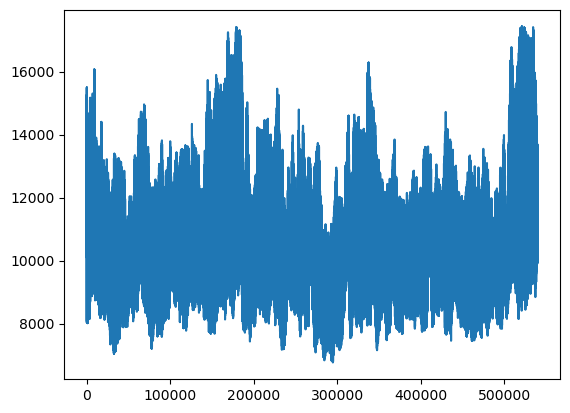

In [269]:
plt.plot(range(len(emcee_trace[:,0])),emcee_trace[:,0])

# Another example
# Fitting continuum + emission line model to a spectrum

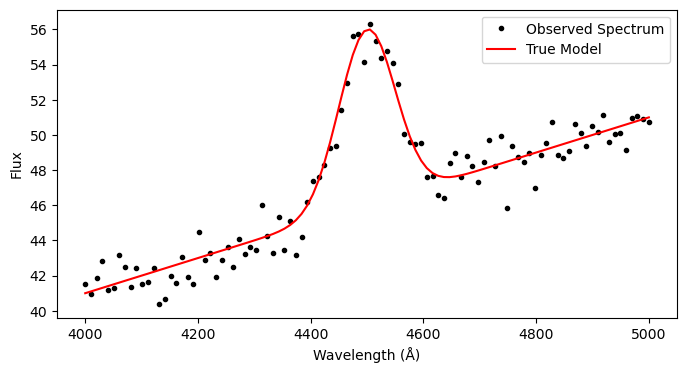

In [80]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import norm

# Generate synthetic spectral data
np.random.seed(42)
wavelengths = np.linspace(4000, 5000, 100)  # Wavelength range (Angstroms)

# True parameters for the toy model
true_params = {
    "A": 10,            # Emission line amplitude
    "lambda_0": 4500,   # Central wavelength
    "sigma": 50,        # Line width
    "m": 0.01,          # Continuum slope
    "b": 1.0            # Continuum intercept
}

# Generate true spectrum
def toy_spectrum(wavelengths, A, lambda_0, sigma, m, b):
    gaussian = A * np.exp(-((wavelengths - lambda_0) ** 2) / (2 * sigma ** 2))
    continuum = m * wavelengths + b
    return gaussian + continuum

true_flux = toy_spectrum(wavelengths, **true_params)

# Add Gaussian noise
noise_level = 1.0
observed_flux = true_flux + np.random.normal(0, noise_level, size=wavelengths.shape)

# Plot the synthetic spectrum
plt.figure(figsize=(8, 4))
plt.plot(wavelengths, observed_flux, 'k.', label="Observed Spectrum")
plt.plot(wavelengths, true_flux, 'r-', label="True Model")
plt.xlabel("Wavelength (Å)")
plt.ylabel("Flux")
plt.legend()
plt.show()

Acceptance rate: 0.00083


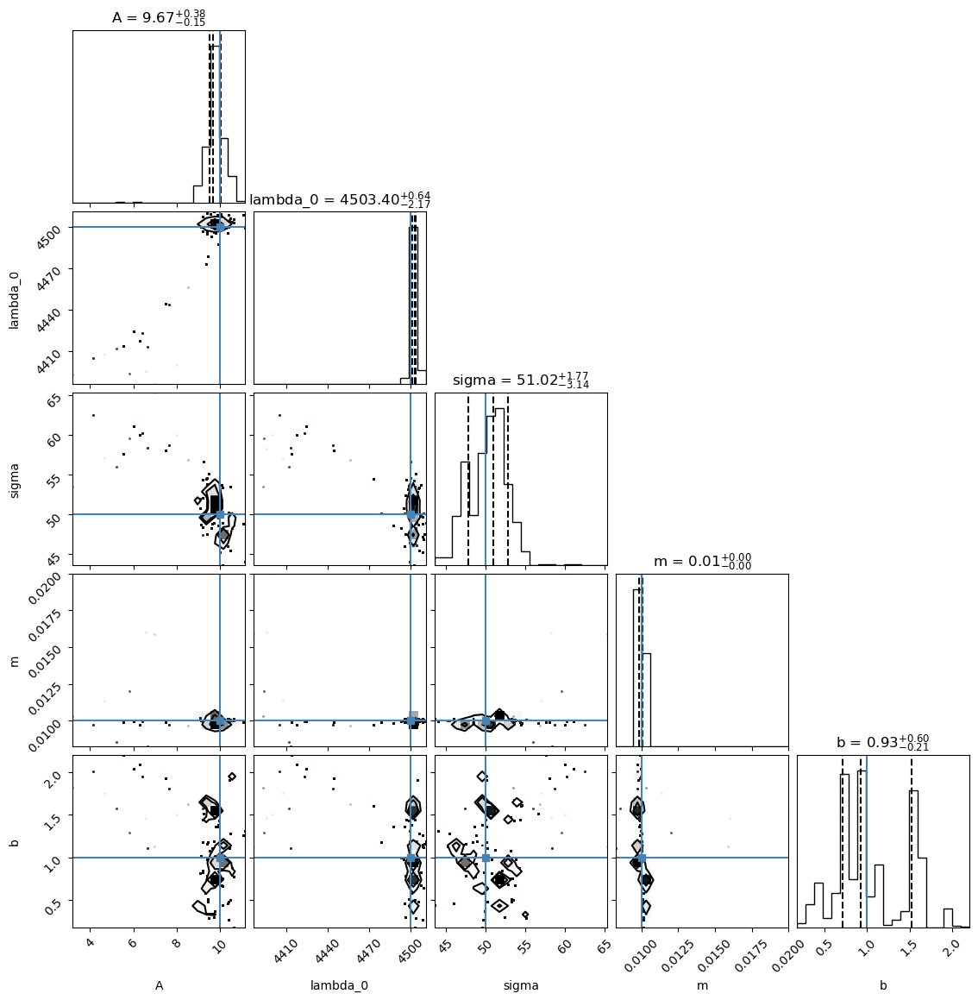

In [81]:
def log_likelihood(wavelengths, observed_flux, noise_level, A, lambda_0, sigma, m, b):
    model_flux = toy_spectrum(wavelengths, A, lambda_0, sigma, m, b)
    residuals = observed_flux - model_flux
    logL = -0.5 * np.sum((residuals / noise_level) ** 2)  # Gaussian likelihood
    return logL

def log_prior(A, lambda_0, sigma, m, b): 
    #if lambda_0 < 4000 or lambda_0 > 5000 or sigma < 0 or sigma > 1000:
    #    return -1e10
    #else: 
    return 0

def log_posterior(wavelengths, observed_flux, noise_level, A, lambda_0, sigma, m, b):
    return log_likelihood(wavelengths, observed_flux, noise_level, A, lambda_0, sigma, m, b) + log_prior(A, lambda_0, sigma, m, b)


from scipy.stats import norm

# Initial parameters and step sizes for MCMC
initial_params = [8, 4400, 60, 0.02, 1.5]  # Initial guess
step_sizes = [1, 10, 5, 0.005, 0.2]  # Proposal step sizes
n_samples = 100000  # Number of MCMC samples

# Run Metropolis-Hastings
samples = Metropolis_Hastings(data = [wavelengths, observed_flux, noise_level], N= 100000, params_init=initial_params, proposal_width=step_sizes)
samples = np.array(samples)

import corner

# Labels for each parameter
param_names = ["A", "lambda_0", "sigma", "m", "b"]

# Generate the corner plot
fig = corner.corner(samples, labels=param_names, truths=[true_params[p] for p in param_names],
                    quantiles=[0.16, 0.5, 0.84], show_titles=True, title_kwargs={"fontsize": 12})

plt.show()
